In [5]:
import eDiskplot as eplot
from qdisk.plot import ChannelMap
from qdisk.classes import FitsImage
import analysis_utils as au
from eDisk_source_dict import source_dict
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
from astropy.visualization import ImageNormalize
%matplotlib widget
%load_ext autoreload
%autoreload 2

source = "L1489IRS"
config = "SBLB"
line = "SO"
robust = 1.0
center_coord = source_dict[source]["radec"]
PA = source_dict[source]["PA"]
incl = source_dict[source]["incl"]
distance = source_dict[source]["distance"]
vsys = source_dict[source]["v_sys"]

imagename = au.customimagepath + au.get_image_basename(source, config, line, robust=robust)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
linelist = ["12CO", "13CO", "C18O", "SO"]
robust = {"12CO": 0.5, "13CO": 0.5, "C18O": 1.0, "SO": 1.0}
rmax = 1

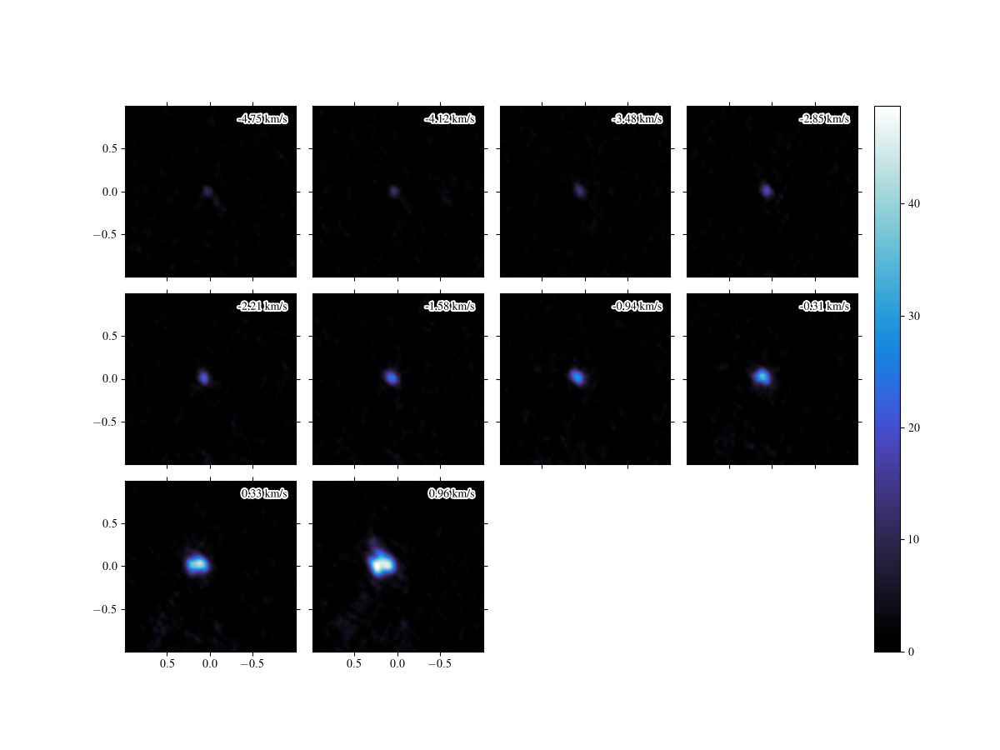

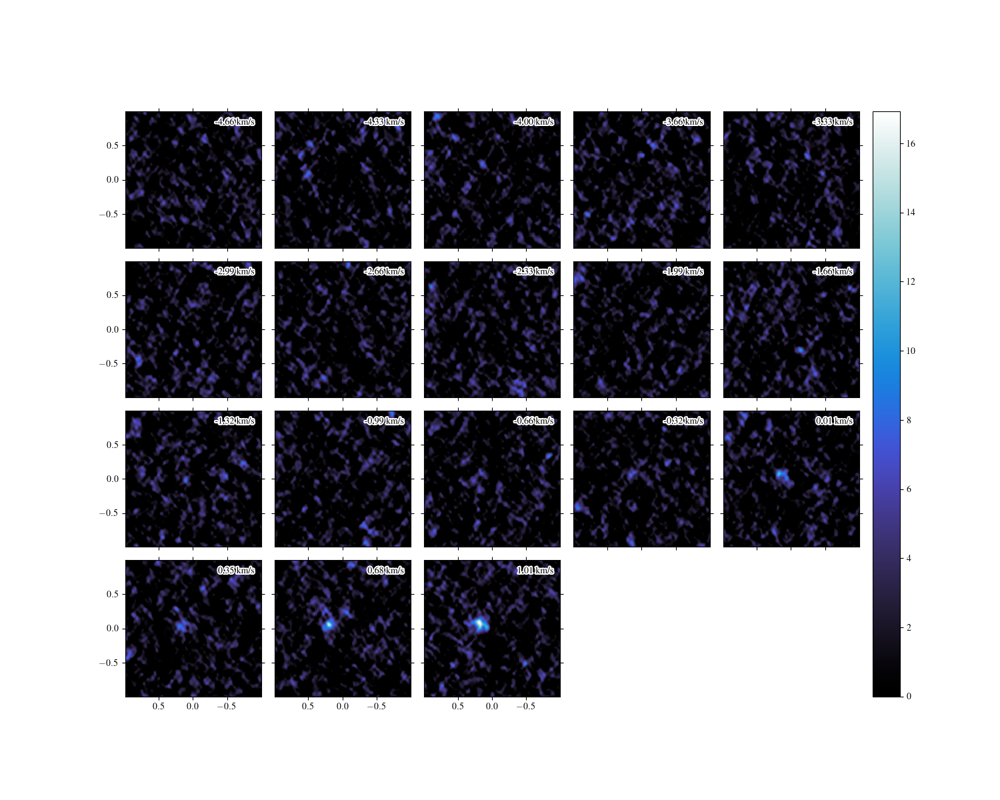

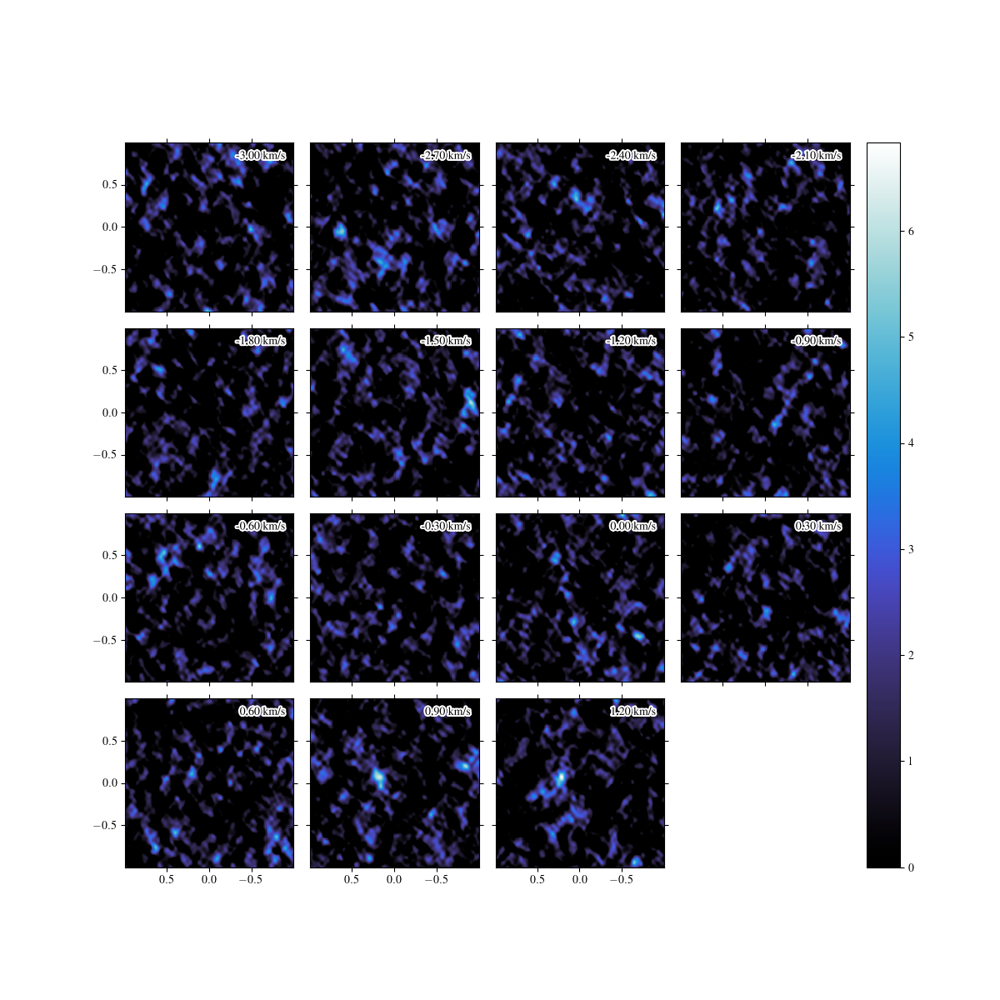

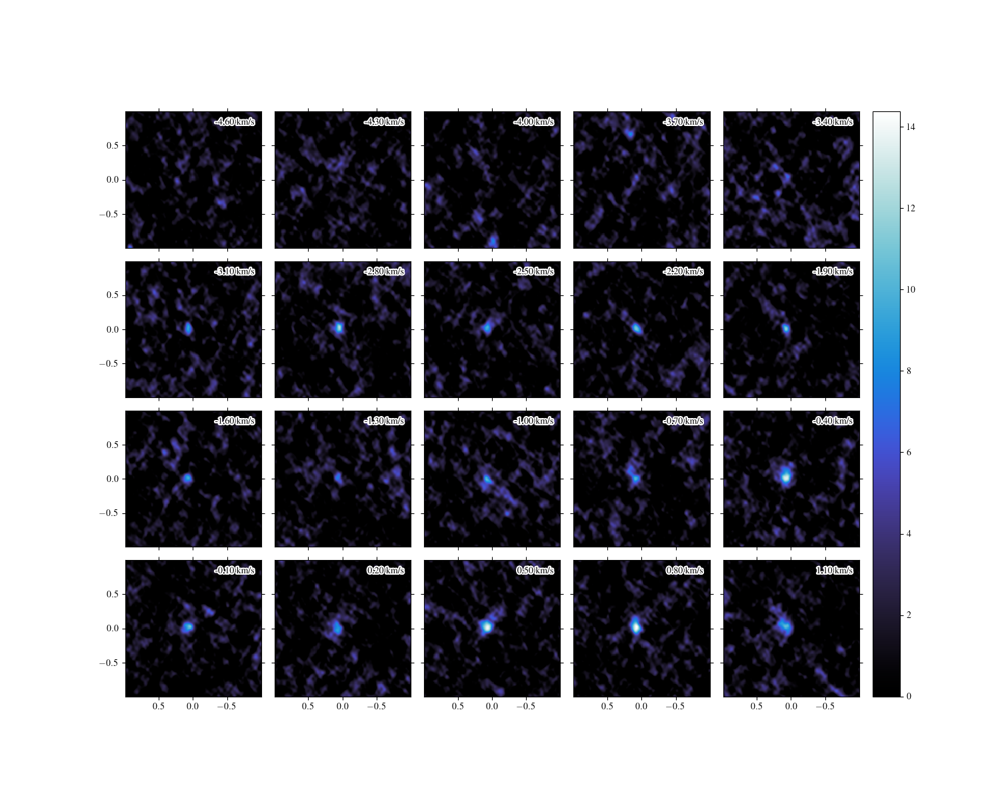

In [14]:
vmin = vsys - 12
vmax = vsys - 6
for line in linelist:
    imagename = au.customimagepath + au.get_image_basename(source, config, line, robust=robust[line])
    chanmap = ChannelMap(imagename, xlim=(-rmax, rmax), ylim=(-rmax, rmax), vlim=(vmin, vmax), data_scaling_factor=1e3, center_coord=center_coord, downsample=(1,2) if line == "13CO" else None)
    chanmap.set_imagegrid(pad=0.2, colorbar=True)
    chanmap.plot_colormap(cmap=eplot.cmap["M0"], vmin=0.0)

    chanmap.fig.savefig(au.figurepath+"{}_channelmap_high_blue.pdf".format(line), bbox_inches="tight", pad_inches=0.01)

/home/yamato/Project/eDisk/firstlook_L1489IRS/.venv/lib/python3.8/site-packages/qdisk/plot.py:817: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  self.fig = plt.figure(figsize=self._get_figsize())


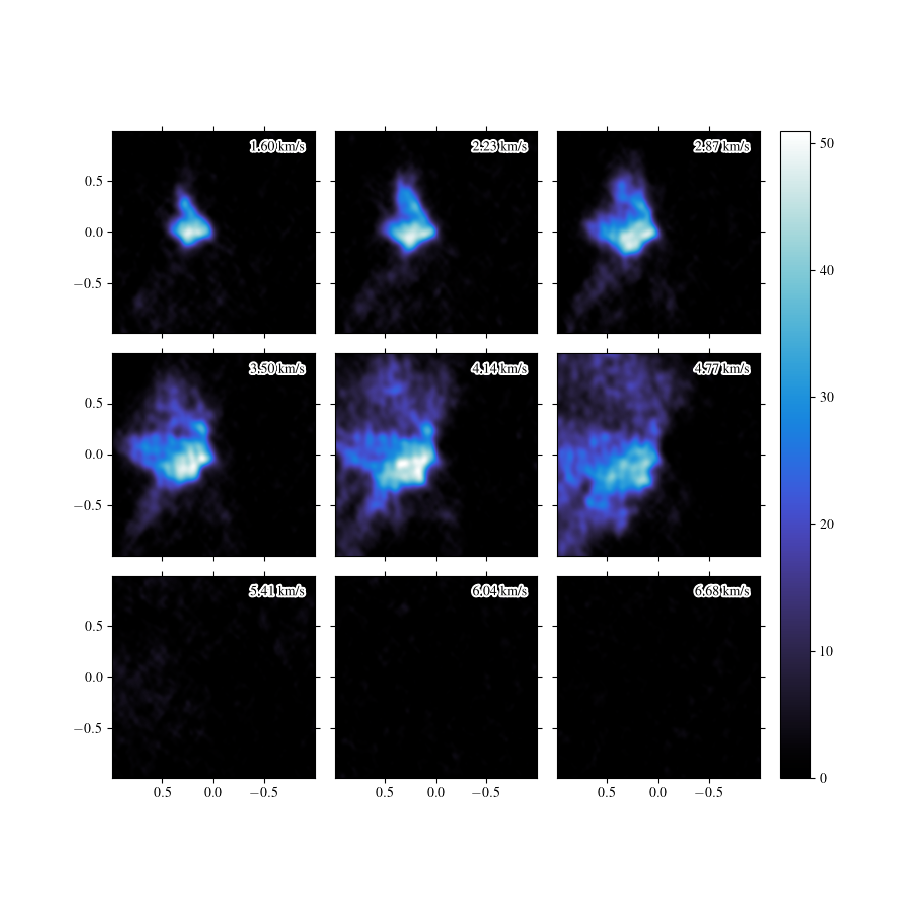

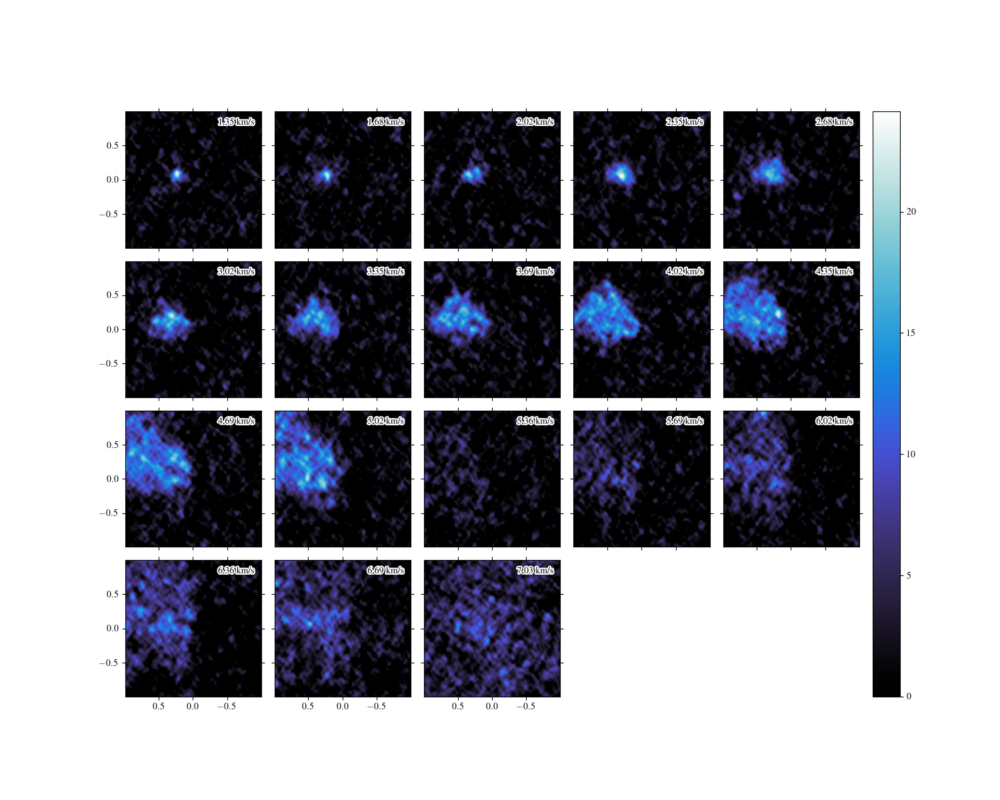

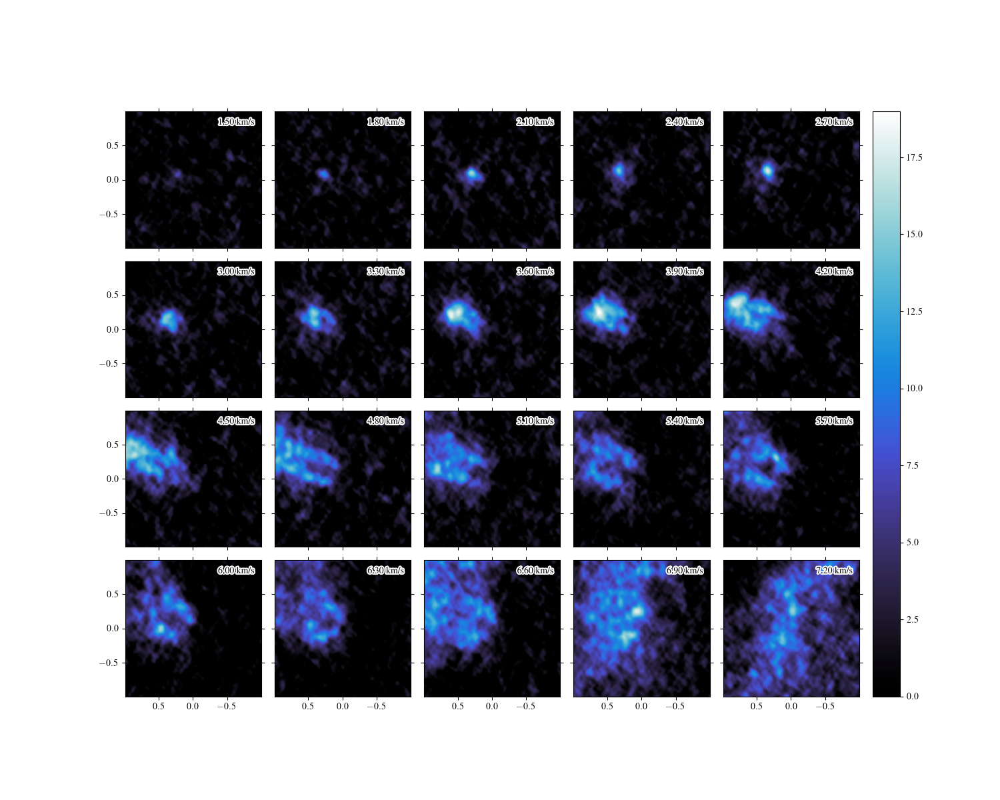

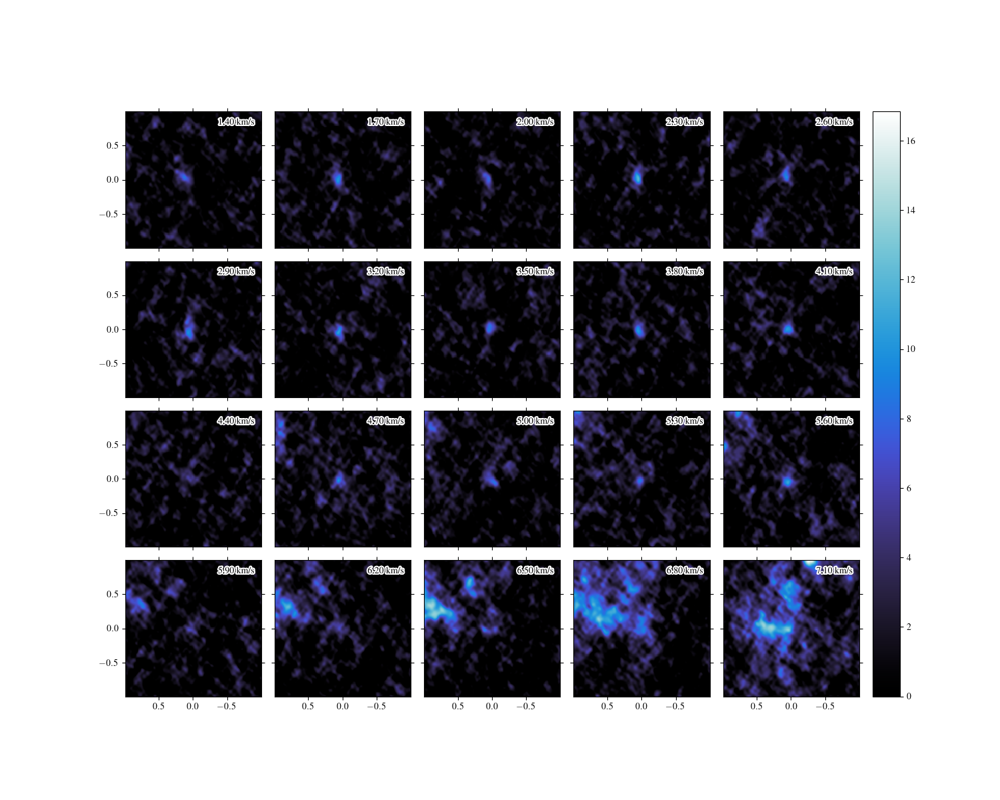

In [15]:
vmin = vsys - 6
vmax = vsys - 0
for line in linelist:
    imagename = au.customimagepath + au.get_image_basename(source, config, line, robust=robust[line])
    chanmap = ChannelMap(imagename, xlim=(-rmax, rmax), ylim=(-rmax, rmax), vlim=(vmin, vmax), data_scaling_factor=1e3, center_coord=center_coord, downsample=(1,2) if line == "13CO" else None)
    chanmap.set_imagegrid(pad=0.2, colorbar=True)
    chanmap.plot_colormap(cmap=eplot.cmap["M0"], vmin=0.0)

    chanmap.fig.savefig(au.figurepath+"{}_channelmap_low_blue.pdf".format(line), bbox_inches="tight", pad_inches=0.01)

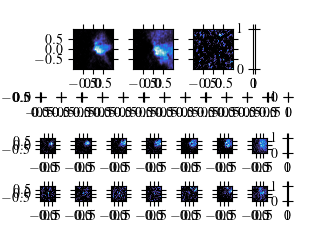

In [7]:
vrange = (0, 4)

fig = plt.figure()

for i, line in enumerate(linelist):
    imagename = au.customimagepath + au.get_image_basename(source, config, line, robust=robust[line])
    cube = FitsImage(imagename, xlim=(-rmax, rmax), ylim=(-rmax, rmax), vlim=(vsys-vrange[1], vsys-vrange[0]), downsample=(1, 2))
    cube.shift_phasecenter_toward(center_coord)
    imgrid = ImageGrid(fig, rect=411+i, nrows_ncols=(1, cube.nchan), axes_pad=0.2, share_all=False, cbar_mode="single")

    for i, v in enumerate(cube.v):

        ax = imgrid[i]

        ax.pcolorfast(cube.x, cube.y, cube.data[i]*1e3, cmap=eplot.cmap["M0"], vmin=0.0)


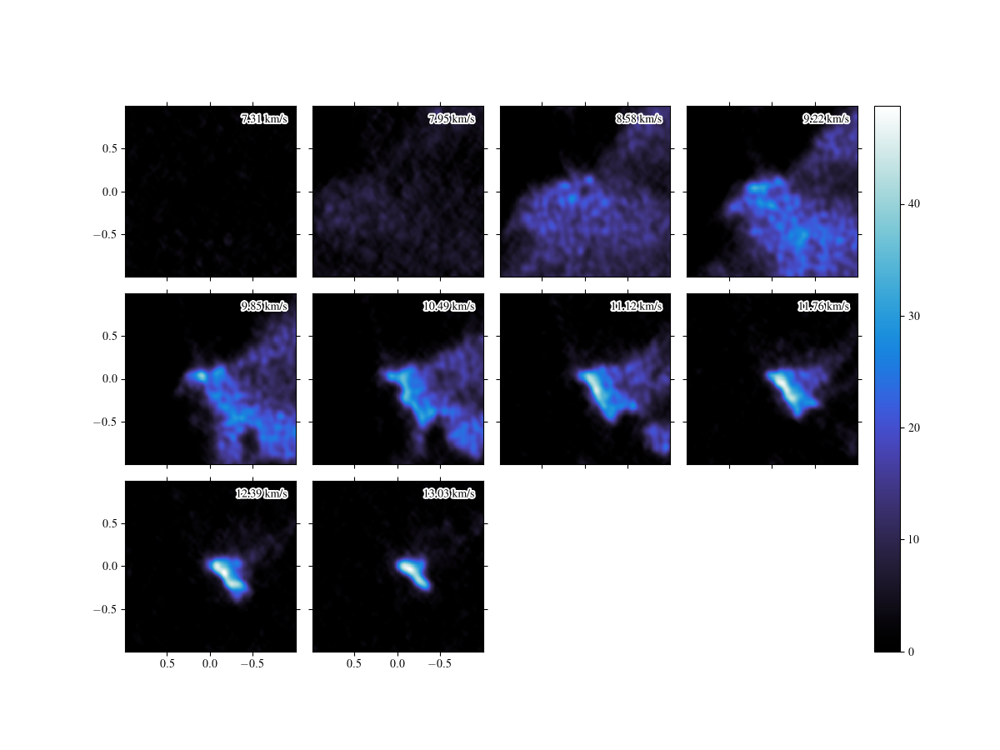

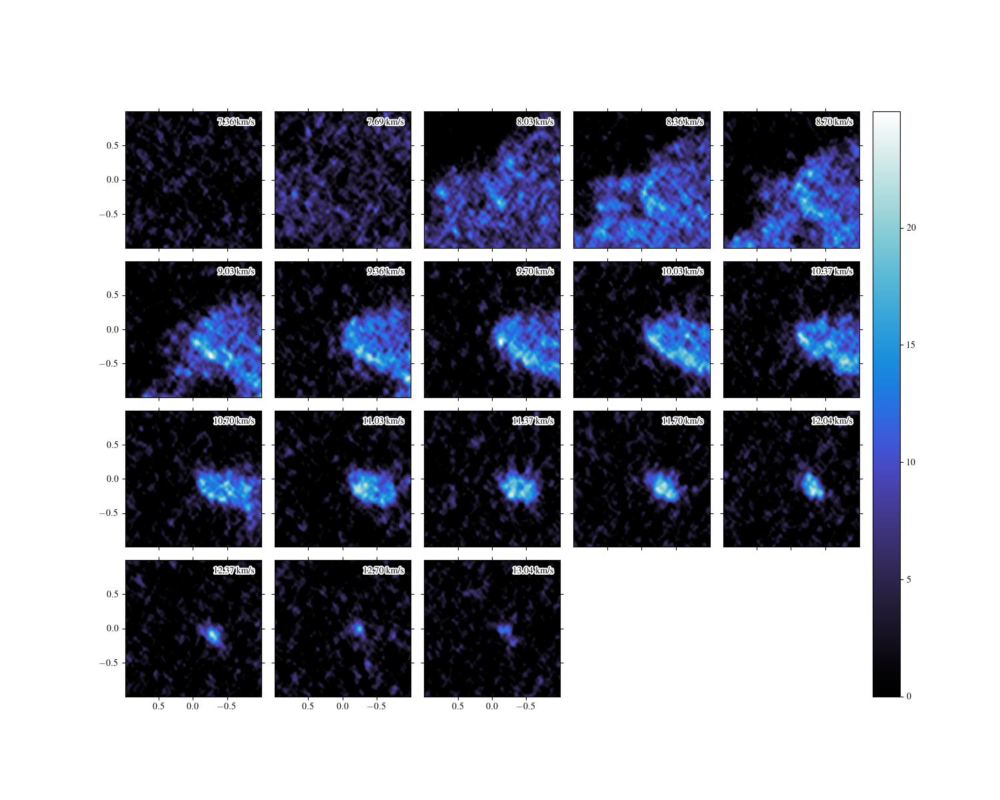

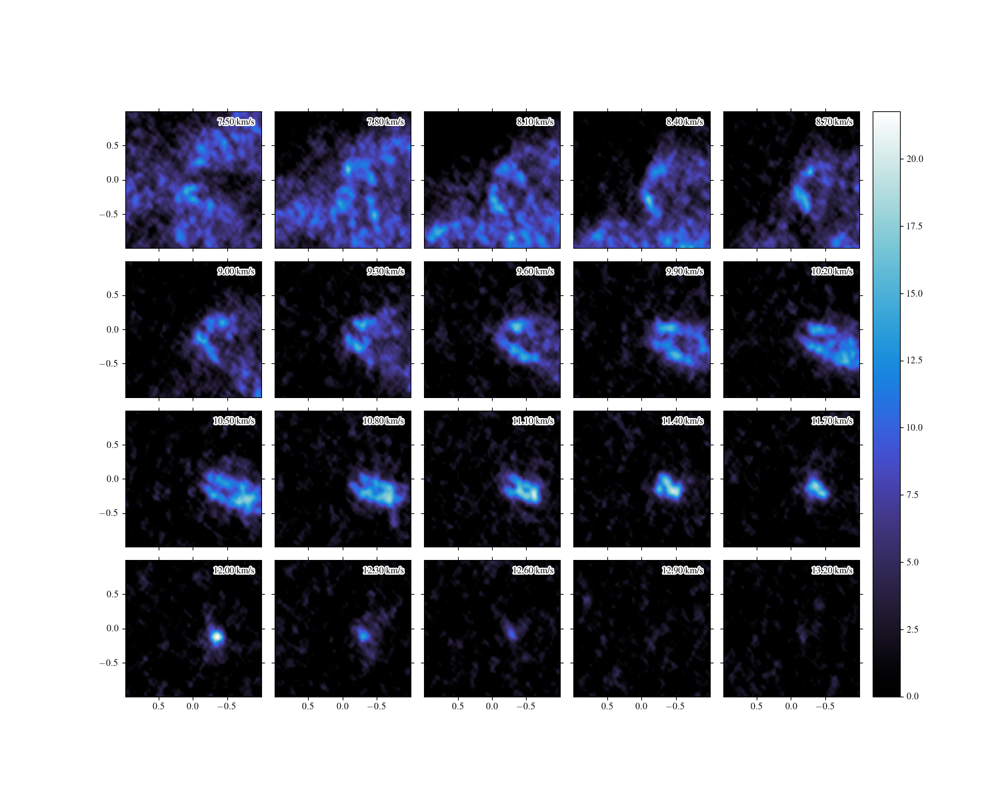

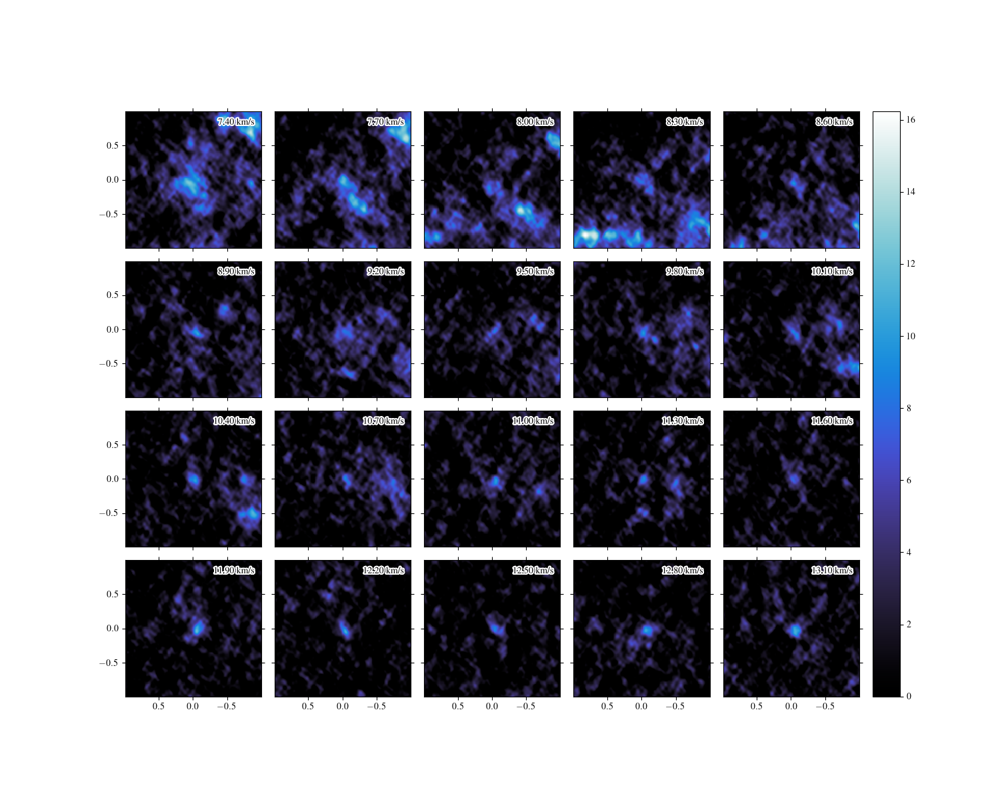

In [17]:
vmin = vsys + 0
vmax = vsys + 6
for line in linelist:
    imagename = au.customimagepath + au.get_image_basename(source, config, line, robust=robust[line])
    chanmap = ChannelMap(imagename, xlim=(-rmax, rmax), ylim=(-rmax, rmax), vlim=(vmin, vmax), data_scaling_factor=1e3, center_coord=center_coord, downsample=(1,2) if line == "13CO" else None)
    chanmap.set_imagegrid(pad=0.2, colorbar=True)
    chanmap.plot_colormap(cmap=eplot.cmap["M0"], vmin=0.0)

    chanmap.fig.savefig(au.figurepath+"{}_channelmap_low_red.pdf".format(line), bbox_inches="tight", pad_inches=0.01)

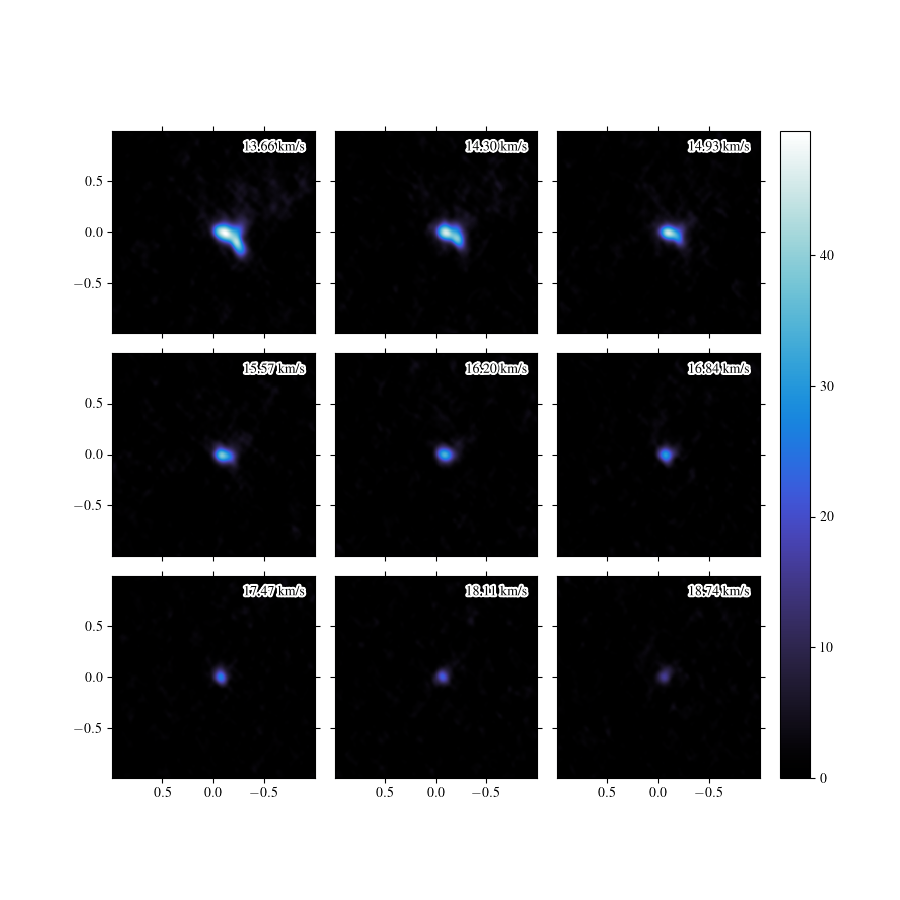

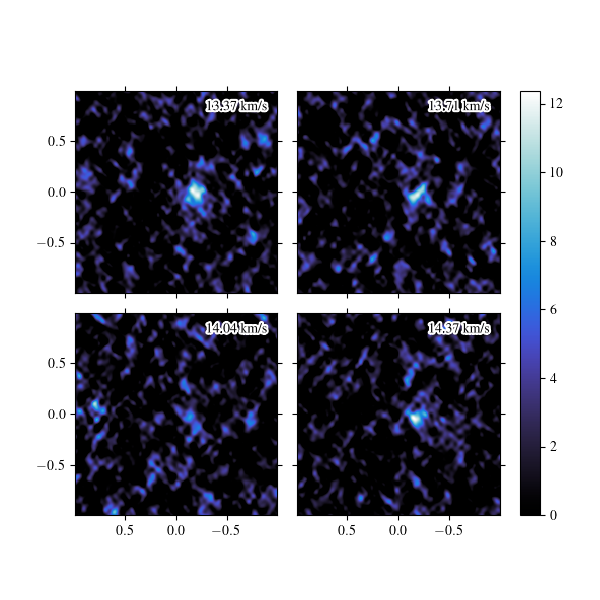

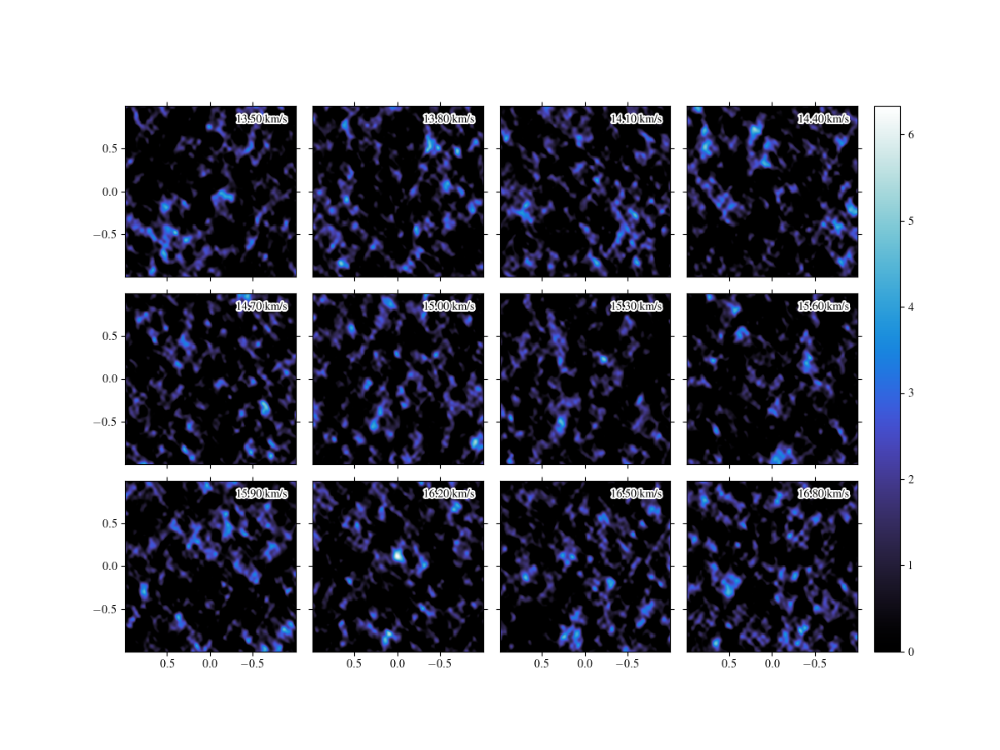

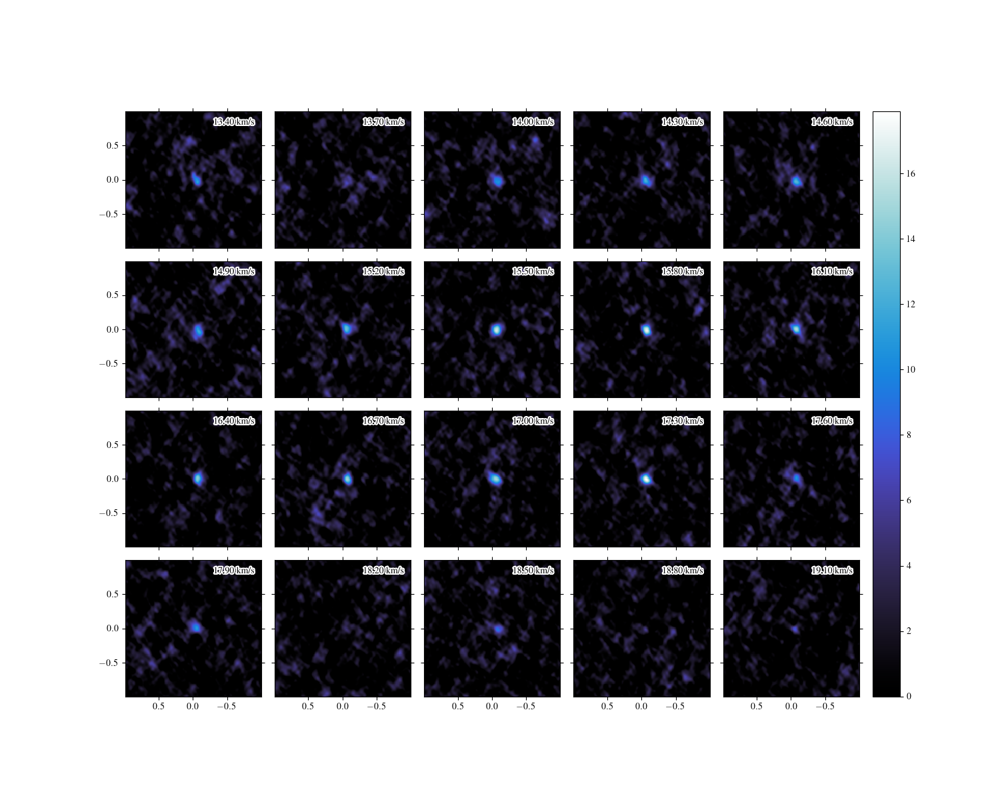

In [3]:
vmin = vsys + 6
vmax = vsys + 12
for line in linelist:
    imagename = au.customimagepath + au.get_image_basename(source, config, line, robust=robust[line])
    chanmap = ChannelMap(imagename, xlim=(-rmax, rmax), ylim=(-rmax, rmax), vlim=(vmin, vmax), data_scaling_factor=1e3, center_coord=center_coord, downsample=(1,2) if line == "13CO" else None)
    chanmap.set_imagegrid(pad=0.2, colorbar=True)
    chanmap.plot_colormap(cmap=eplot.cmap["M0"], vmin=0.0)

    chanmap.fig.savefig(au.figurepath+"{}_channelmap_high_red.pdf".format(line), bbox_inches="tight", pad_inches=0.01)

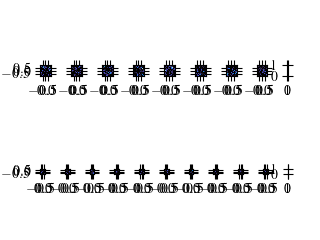

In [4]:
# SO and C18O
vmin = vsys - 12
vmax = vsys - 6

linelist = ["C18O", "SO"]

fig = plt.figure()

# SO

imagename = au.customimagepath + au.get_image_basename(source, config, line, robust=robust[line])
cube = FitsImage(imagename, xlim=(-rmax, rmax), ylim=(-rmax, rmax), vlim=(vmin, vmax), downsample=(1, 2))
cube.shift_phasecenter_toward(center_coord)
imgrid = ImageGrid(fig, rect=211+i, nrows_ncols=(1, cube.nchan), axes_pad=0.2, share_all=False, cbar_mode="single")

norm = 

# for i, line in enumerate(linelist):
#     imagename = au.customimagepath + au.get_image_basename(source, config, line, robust=robust[line])
#     cube = FitsImage(imagename, xlim=(-rmax, rmax), ylim=(-rmax, rmax), vlim=(vmin, vmax), downsample=(1, 2))
#     cube.shift_phasecenter_toward(center_coord)
#     imgrid = ImageGrid(fig, rect=211+i, nrows_ncols=(1, cube.nchan), axes_pad=0.2, share_all=False, cbar_mode="single")

#     norm = 

#     for i, v in enumerate(cube.v):

#         ax = imgrid[i]

#         ax.pcolorfast(cube.x, cube.y, cube.data[i]*1e3, cmap=eplot.cmap["M0"], vmin=0.0)
